#                                Housing Prices Database Management

This file contains all the queries for Stored Procedures and Index.

INSERT ANOMILITIES:

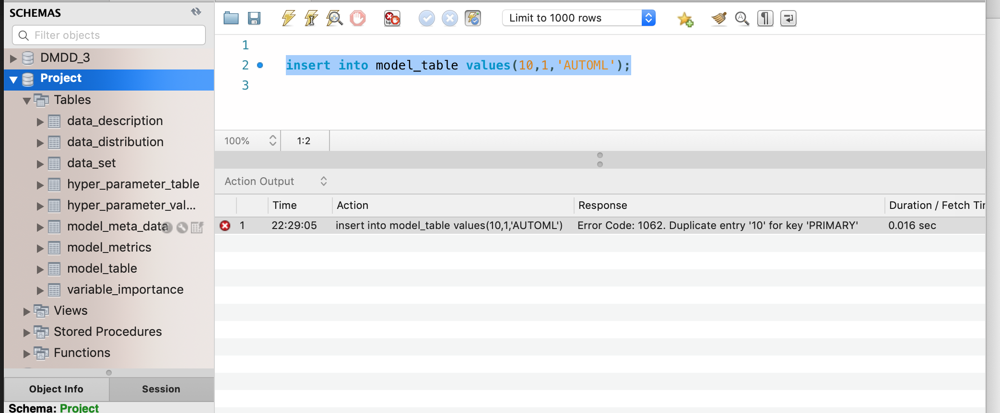

UPDATE ANOMILITIES:

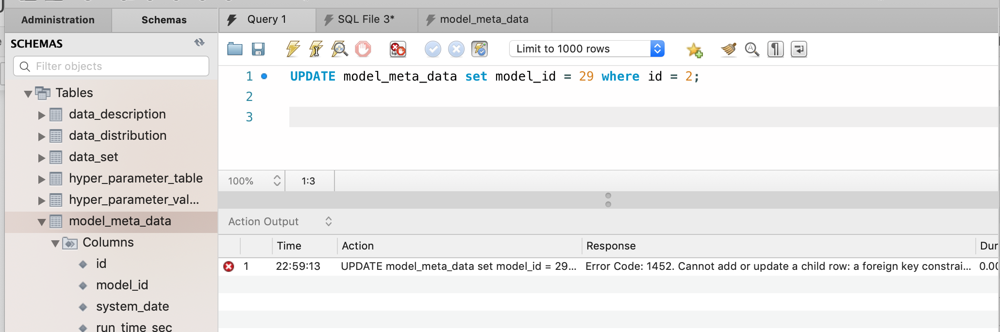

DELETE ANOMILITIES:

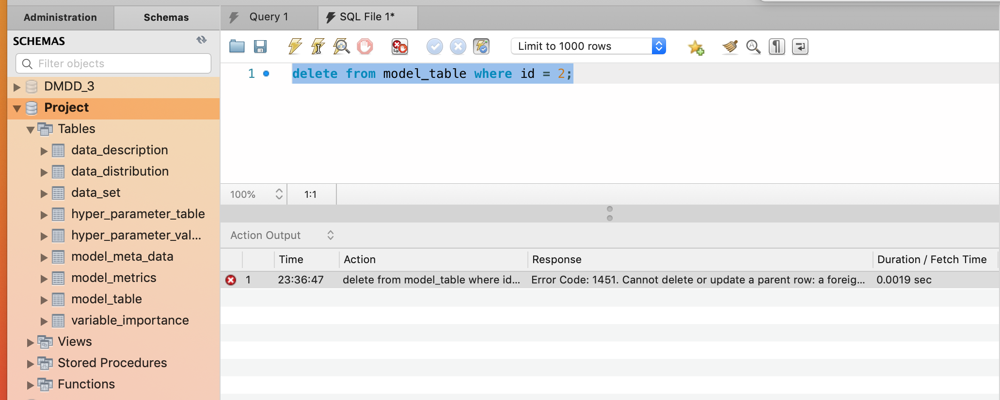

STORED PROCEDURE :

1. For any given hyper parameter for a run time in seconds 1500 list its model id along with its actual hyper parameter value.

    CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_actual_hyper_value`(IN hype varchar(50))
    BEGIN
    select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual from model_table mt inner join   
    model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
    mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
    WHERE hp.hyper_parameter = hype and mm.run_time_sec = 1500;
    END

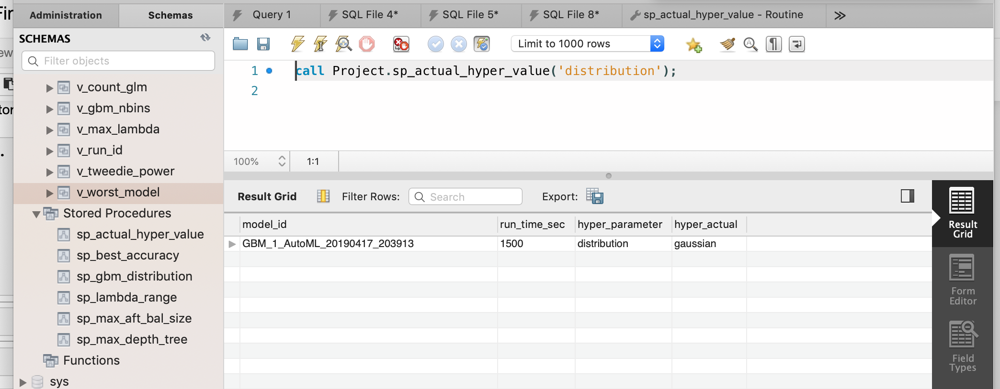

2. List the model with its model id with its run time in seconds which has best accuracy.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_best_accuracy`()
BEGIN
SELECT mt.model_id,mmd.run_time_sec,(SELECT MIN(rmse) from model_metrics) as best_accuracy
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id LIMIT 1;
END


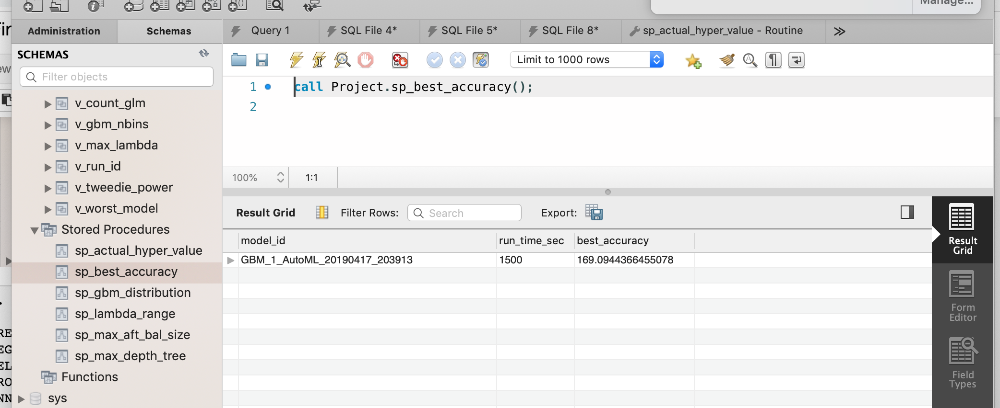

3. List the models along with its model id, run time in seconds for the hyper parameter distribution which has the actual hyper parameter value as distribution for GBM algorithm.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_gbm_distribution`()
BEGIN
select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "distribution" and hpv.hyper_actual = "gaussian";
END

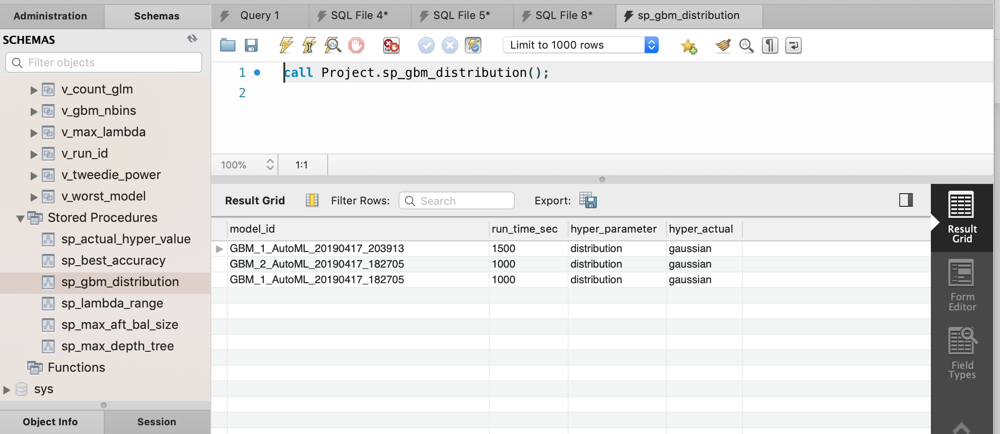

4. List the minimum alpha value, maximum alpha value and the range for the hyperparamter alpha for run time in seconds as 1000 and for the model GLM. 

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_lambda_range`()
BEGIN
select MIN(hpv.hyper_actual) as min_alpha,
MAX(hpv.hyper_actual) as max_alpha, 
(MAX(hpv.hyper_actual) - MIN(hpv.hyper_actual)) as alpha_range
from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter = 'lambda' AND 
mt.model_id like '%GLM%' and mm.run_time_sec = 1000;
END

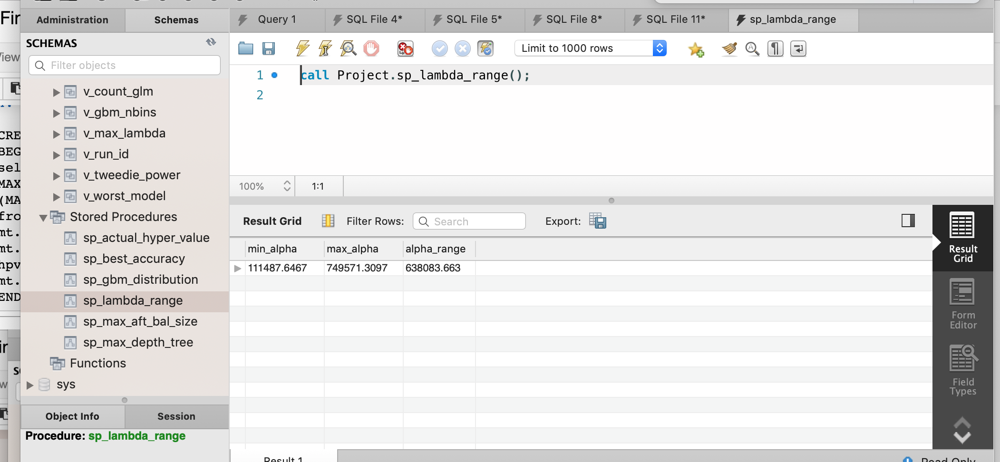

5. For any given run time in seconds list the model id for the hyperparameter max_depth along with its default and actual values for GBM algorithm.

CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_max_depth_tree`(IN seconds integer)
BEGIN
select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual,hpv.hyper_default from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "max_depth" and mm.run_time_sec = seconds and mt.model_id like "%GBM%";
END

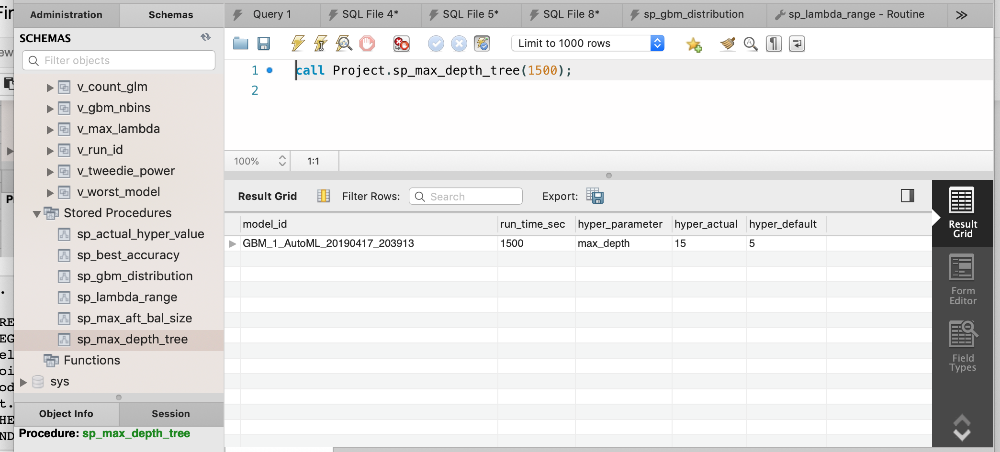

6. List the maximum value for ntrees hyperparameter with its runtime for the GBM model

select mt.model_id, mm.run_time_sec, hp.hyper_parameter,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE  mt.model_id like '%GBM%' and 
hpv.hyper_actual = (select MAX(hyper_actual) 
from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
on hpv.hyper_id = hp.id where hp.hyper_parameter = ntrees);


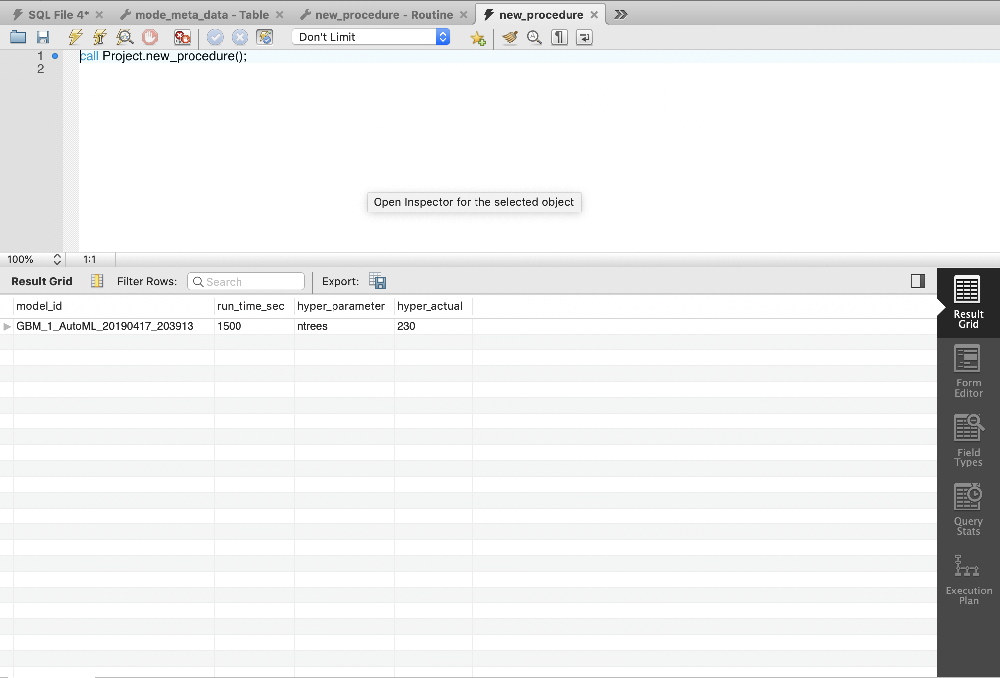

7. List all the models that was run on a particular date.

select mt.model_id,mm.run_time_sec,mm.run_id from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id where system_date = '2019/04/22';



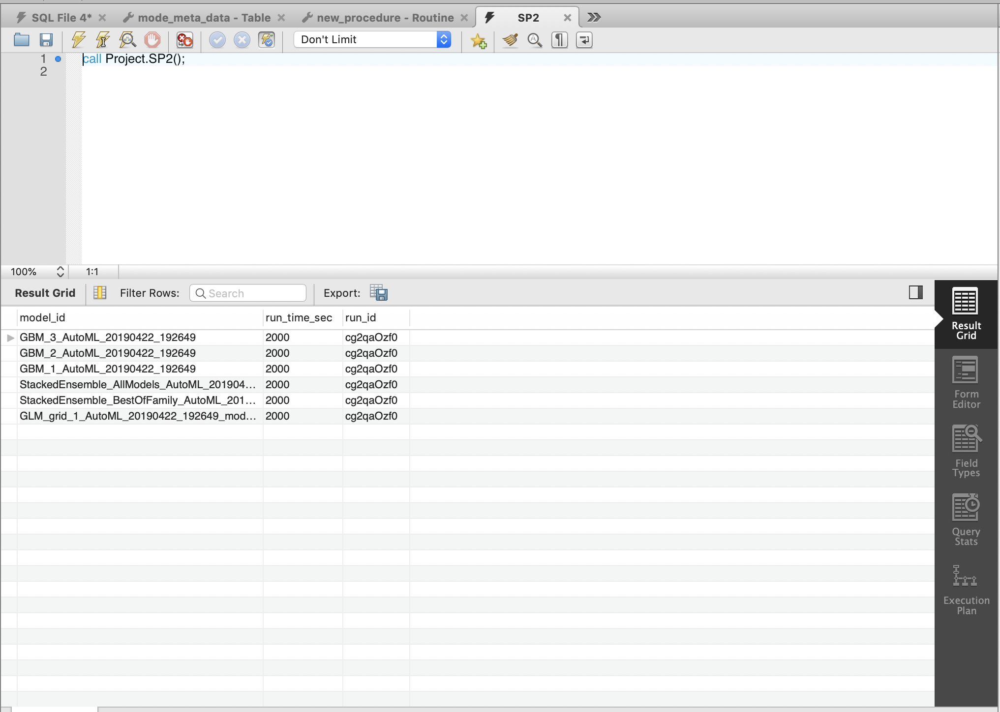

8.List out the least and maximum rmse value for a particular model.


SELECT MIN(mm.rmse) as min_rmse,MAX(rmse) as max_rmse FROM model_table mt 
INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id INNER JOIN hyper_parameter_table hp 
ON mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id WHERE mt.model_id like "%GBM%" and run_time_sec= 1000;


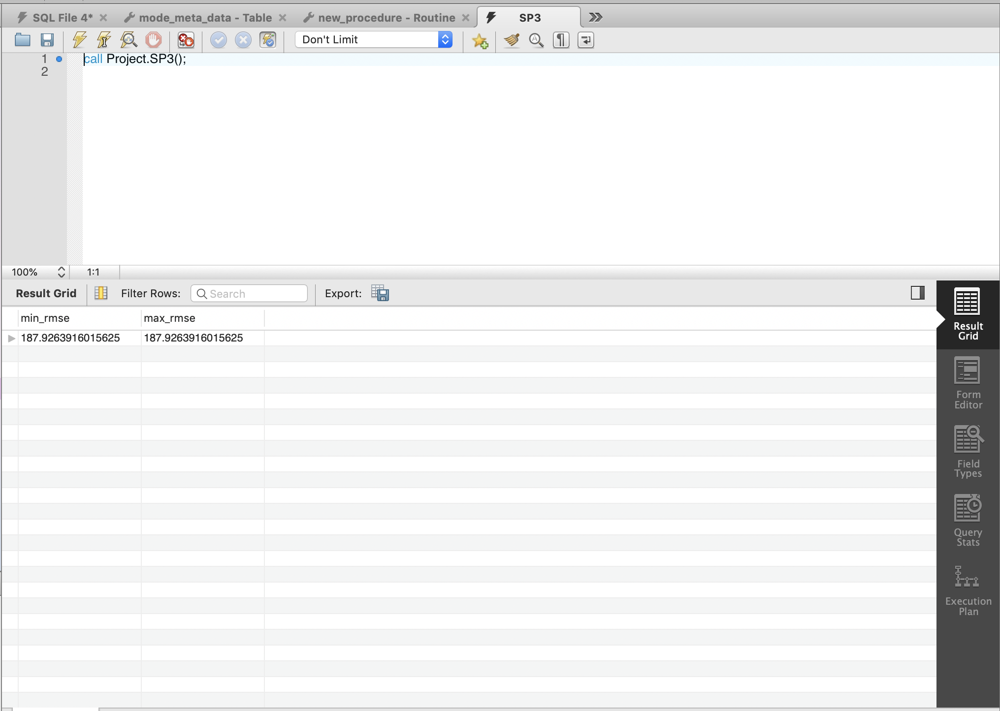

9.List the number of trees, depth of trees, learning rate with actual and default values for a particular model with its run time for GBM model

select mt.model_id, mm.run_time_sec, hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('learn_rate','ntrees','max_depth') AND 
mt.model_id like '%GBM%';



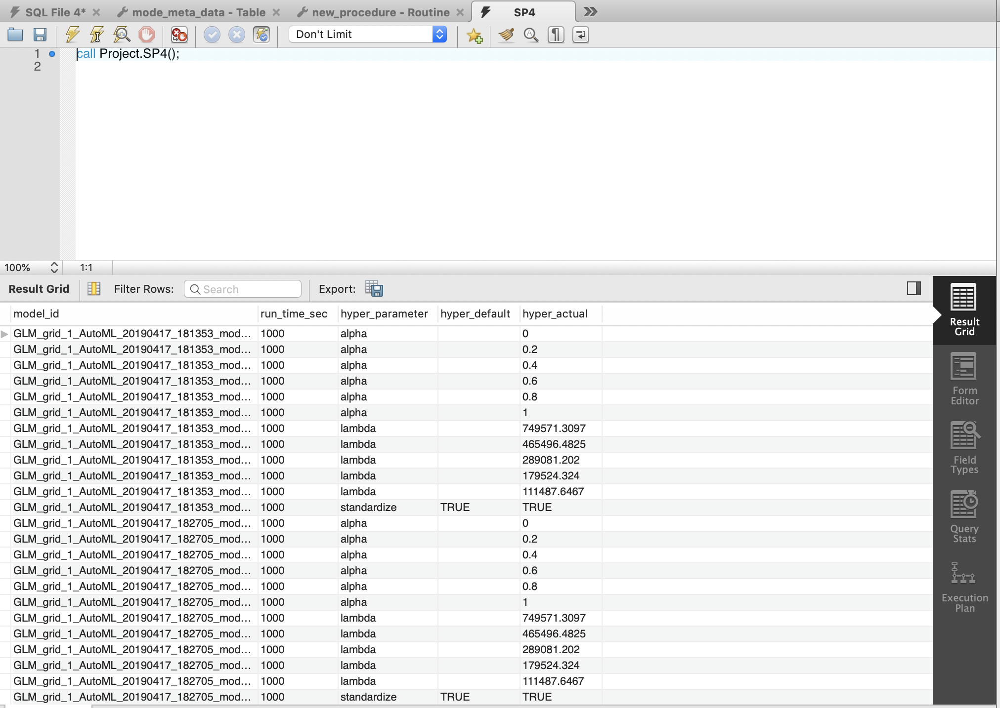

10.Find the best model for any run time based on the rmse value .

SELECT mt.model_id,mmd.run_time_sec,(SELECT MIN(rmse) from model_metrics) as best_accuracy
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id LIMIT 1;


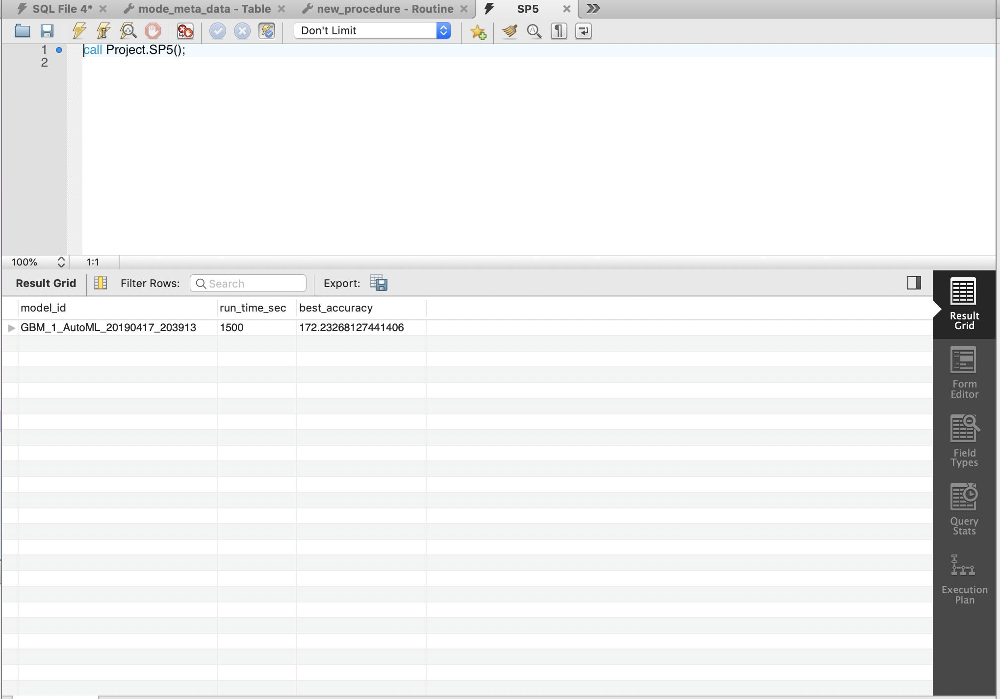

11.List of models which have seed as a hyperparameter 

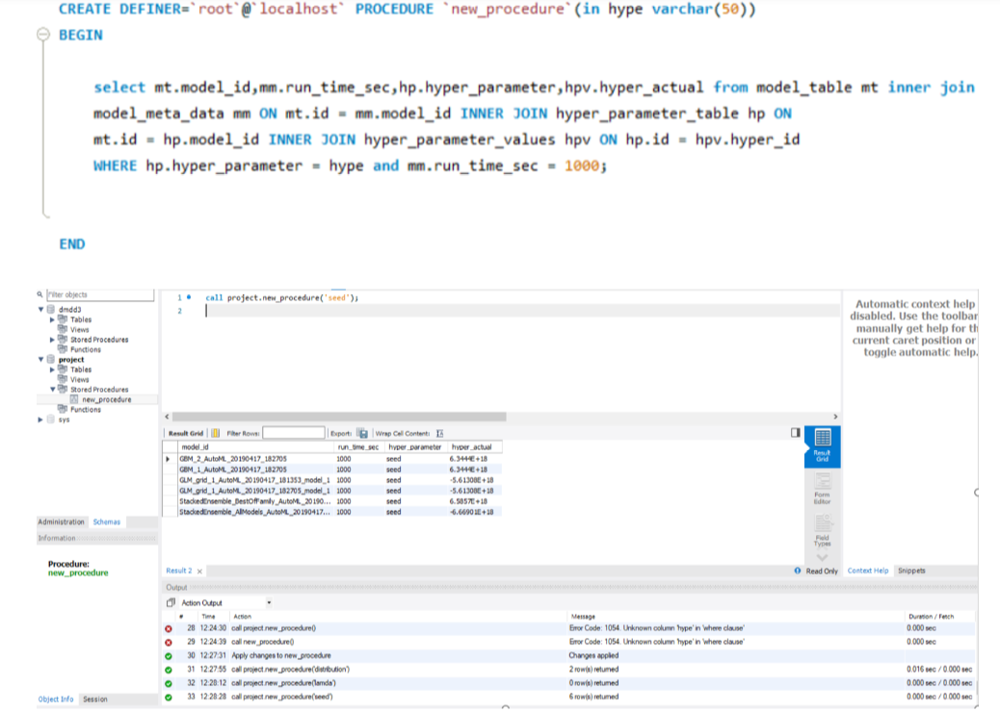

12. List of the actual and default values of hyperparameter lambda, aplha seed,nfolds in GLM model with run_time

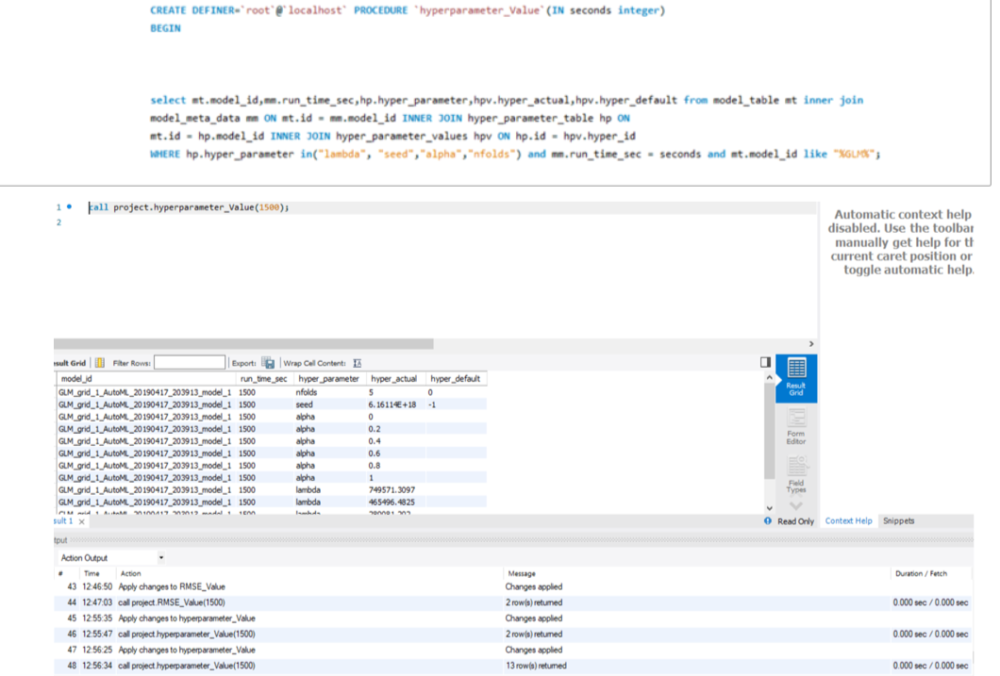

13.List of models which has same system_date ,run_id, run_time_id

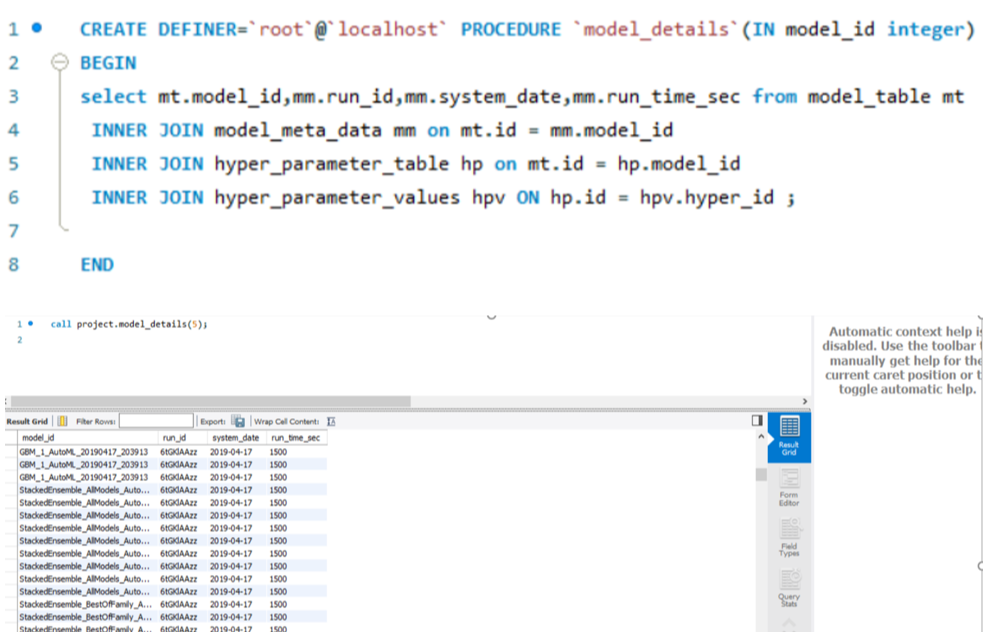

14.To get Max. accuracy

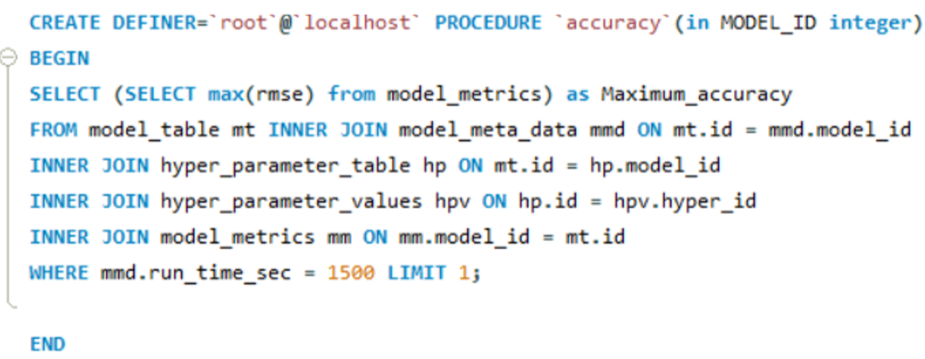

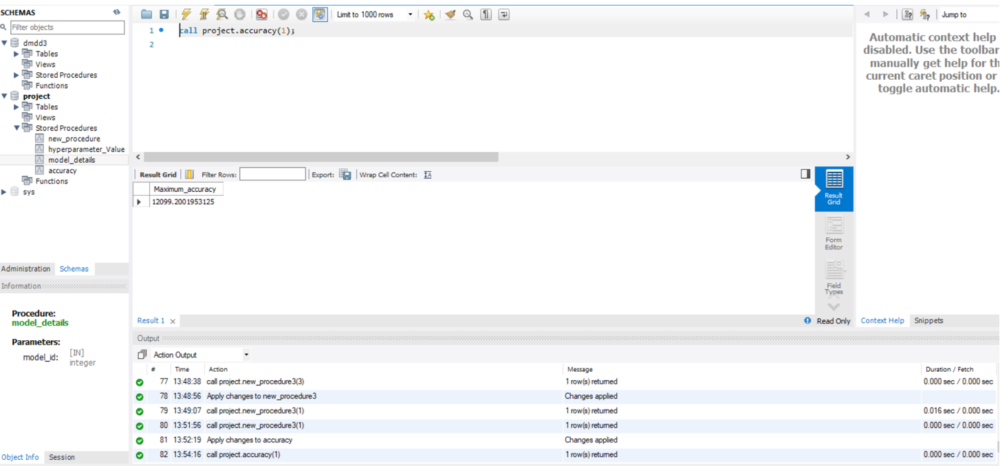

15.CREATE DEFINER=`root`@`localhost` PROCEDURE `sp_max_depth_tree`(IN seconds integer)
BEGIN
select mt.model_id,mm.run_time_sec,hp.hyper_parameter,hpv.hyper_actual,hpv.hyper_default from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
WHERE hp.hyper_parameter = "max_depth" and mm.run_time_sec = seconds and mt.model_id like "%GBM%";
END

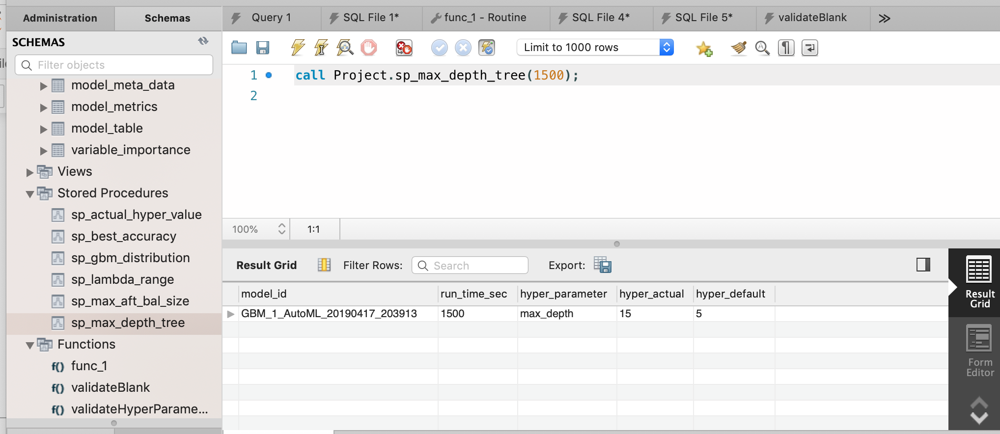

INDEXES: 

1.  select mt.model_id,mm.run_time_sec,mm.run_id from model_table mt inner join 
    model_meta_data mm ON mt.id = mm.model_id where system_date = '2019/04/17';

    create index ind_1 on model_meta_data(run_time_sec);

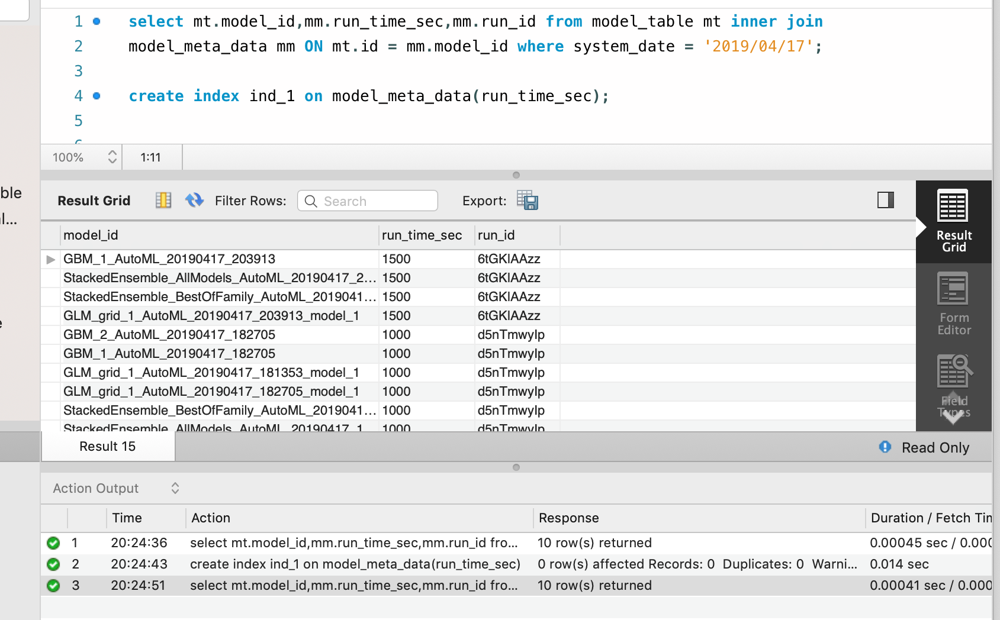

2. 

   SELECT mt.model_id,(SELECT AVG(rmse) from model_metrics) as best_accuracy 
   FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
   INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
   INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
   INNER JOIN model_metrics mm ON mm.model_id = mt.id LIMIT 1; 
 
   create index ind_2 on model_metrics(rmse);

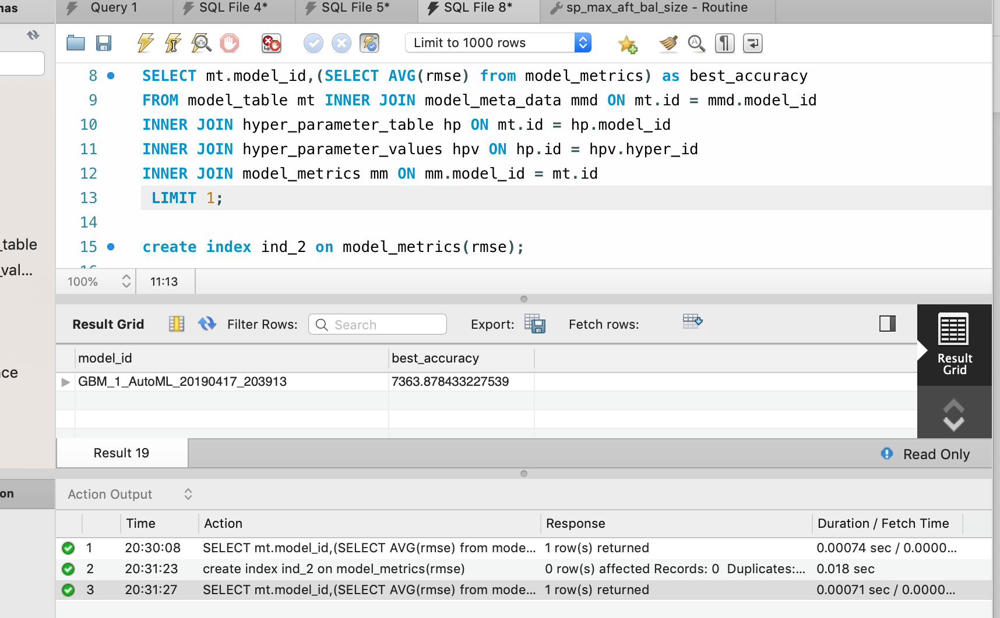

3. select mt.model_id,mm.run_id,mm.system_date,mm.run_time_sec from model_table mt
   INNER JOIN model_meta_data mm on mt.id = mm.model_id INNER JOIN hyper_parameter_table hp
   on mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
   WHERE  hp.hyper_parameter = 'tweedie_link_power' AND hpv.hyper_actual = 1.0;

   create index ind_3 on model_meta_data(run_id);



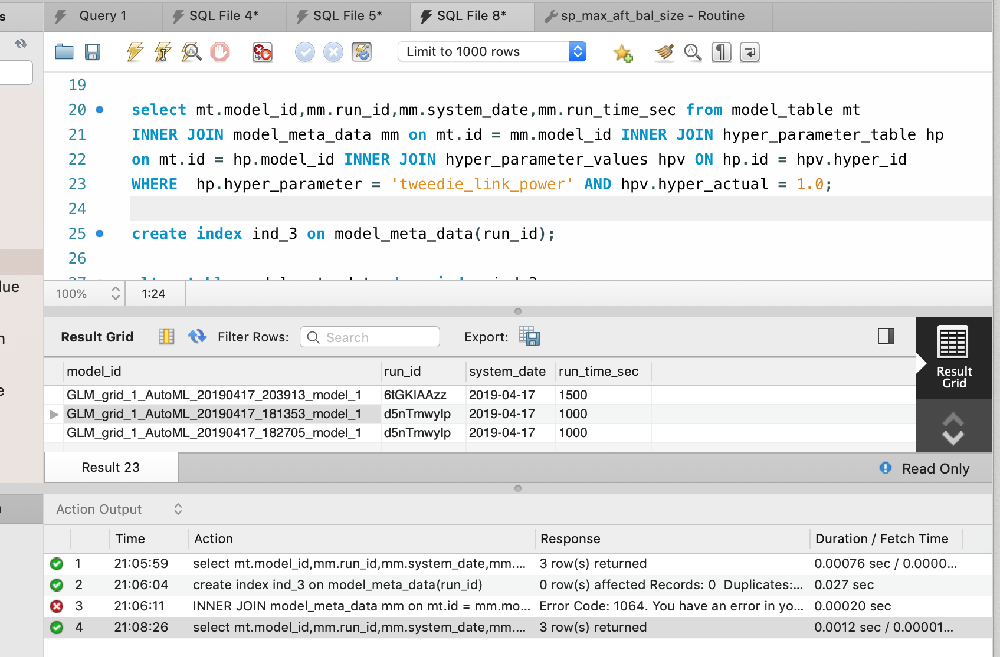

4. select mt.model_id, mm.run_time_sec, hp.hyper_parameter,
   hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
   mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
   mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
   hpv.hyper_id = hp.id WHERE  mt.model_id like '%GLM%' and 
   hpv.hyper_actual = (select MAX(hyper_actual) 
   from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
   on hpv.hyper_id = hp.id where hp.hyper_parameter = 'lambda');

   create index ind_4 on hyper_parameter_values(hyper_actual);


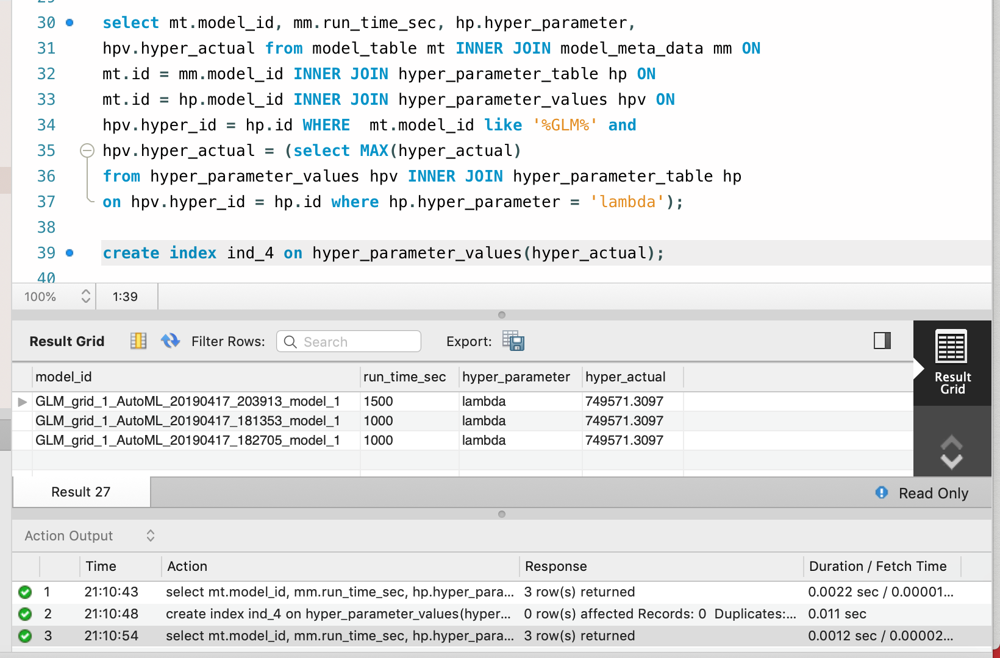

5. select mt.model_id,mm.run_time_sec,hpv.hyper_actual,hpv.hyper_default from model_table mt inner join 
   model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
   mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id 
   WHERE hp.hyper_parameter = "max_after_balance_size";

   create index ind_5 on hyper_parameter_values(hyper_default);


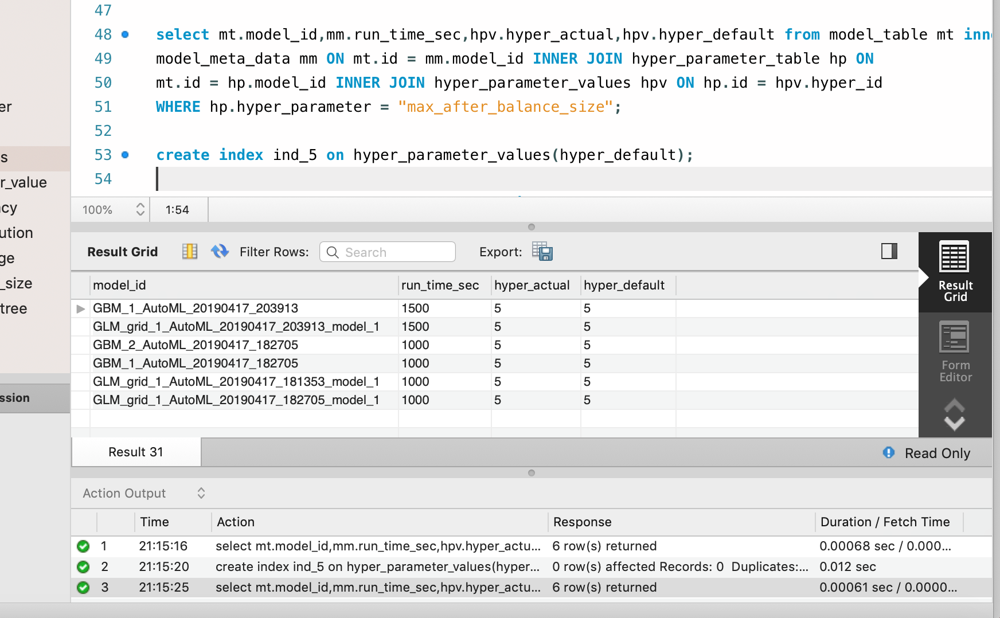

6. select mt.model_id, mm.run_time_sec, hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('seed','standardize','max_iterations') AND 
mt.model_id like '%GLM%';

create index ind_6 on hyper_parameter_table(hyper_parameter);


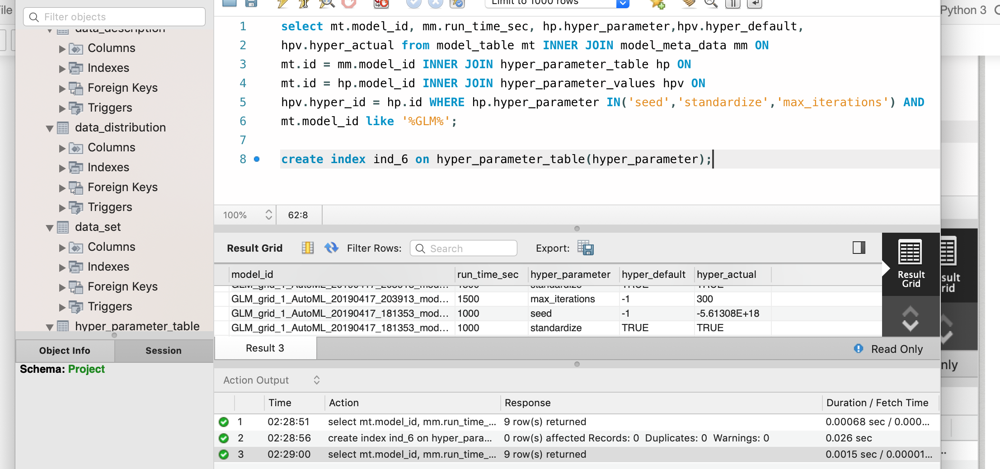

7.select mt.model_id,mm.run_time_sec,mm.run_id from model_table mt inner join 
model_meta_data mm ON mt.id = mm.model_id where system_date = '2019/04/22';

create index ind_7 on model_table(model_id);

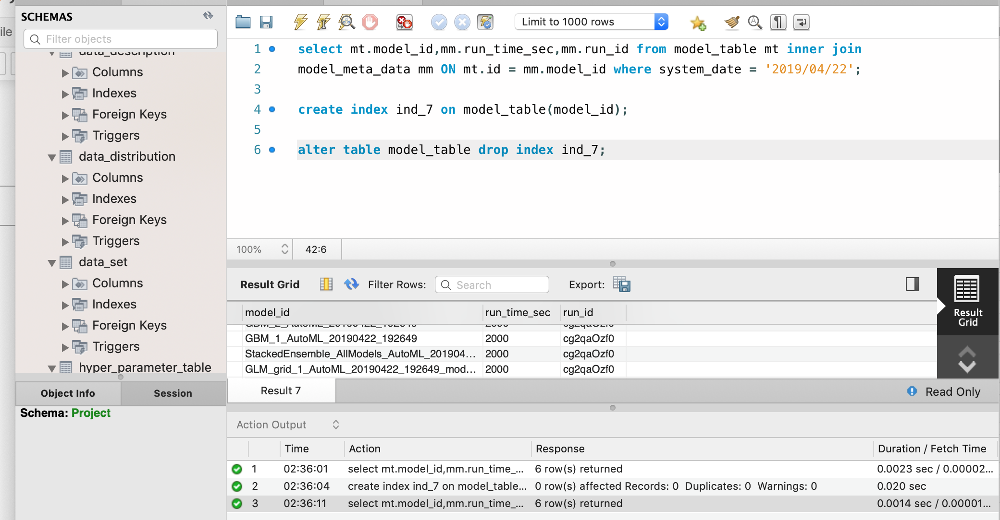

8.select mt.model_id, mm.run_time_sec,mm.system_date, hp.hyper_parameter,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE  mt.model_id like '%GLM%' and 
hpv.hyper_actual = (select MAX(hyper_actual) 
from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
on hpv.hyper_id = hp.id where hp.hyper_parameter = 'aplha');

create index ind_8 on model_meta_data(system_date);

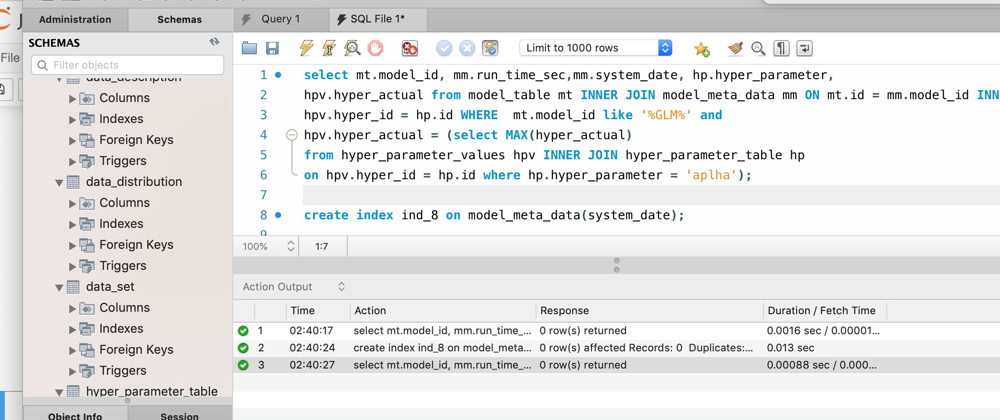

9.SELECT mt.model_id,mmd.run_time_sec,mm.mean_residual_deviance
FROM model_table mt INNER JOIN model_meta_data mmd ON mt.id = mmd.model_id 
INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id 
INNER JOIN hyper_parameter_values hpv ON hp.id = hpv.hyper_id
INNER JOIN model_metrics mm ON mm.model_id = mt.id;

create index ind_9 on model_metrics(mean_residual_deviance);

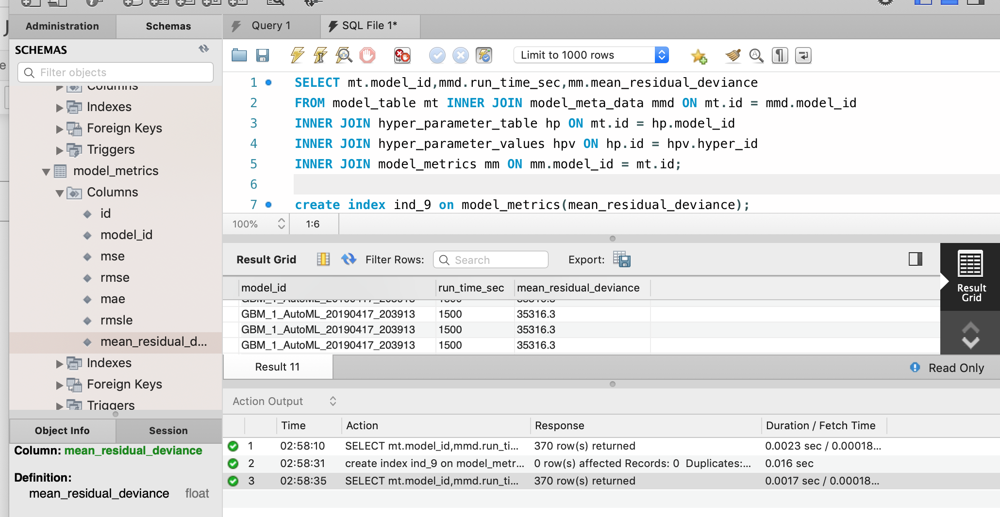

10.select mt.model_id, mm.run_time_sec,mm.start_time,mm.end_time,hp.hyper_parameter,hpv.hyper_default,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON
mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON
mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE hp.hyper_parameter IN('stopping_rounds','stopping_metric','
stopping_tolerance') AND mt.model_id like '%GBM%'; 

create index ind_10 on model_meta_data(end_time);

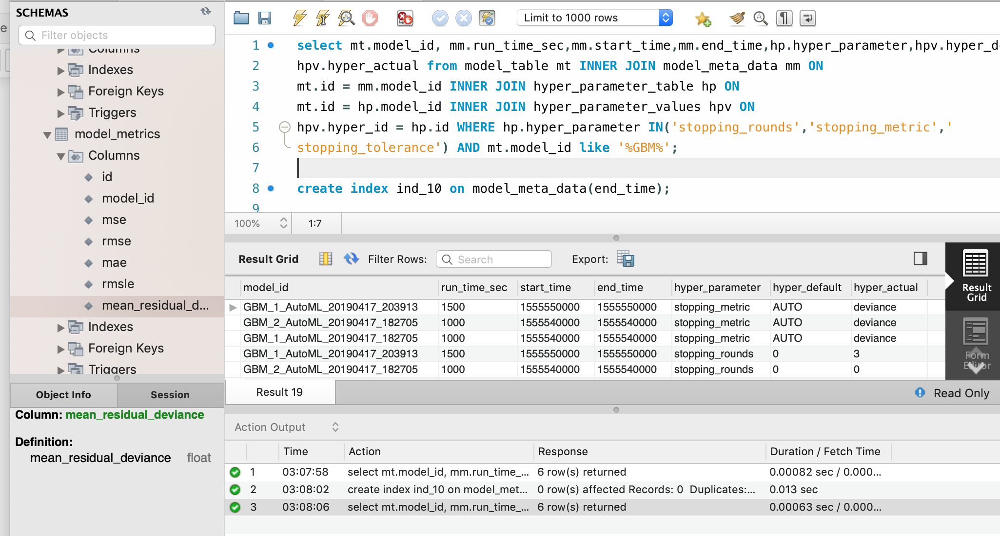

11. List out maximum runtime secs for GLM model






SELECT M.model_id, MAX(MM.run_time_sec) FROM 
model_table M INNER JOIN model_meta_data MM 
ON M.id = MM.model_ID 
GROUP BY M.model_id
HAVING M.model_id LIKE 'GLM%';

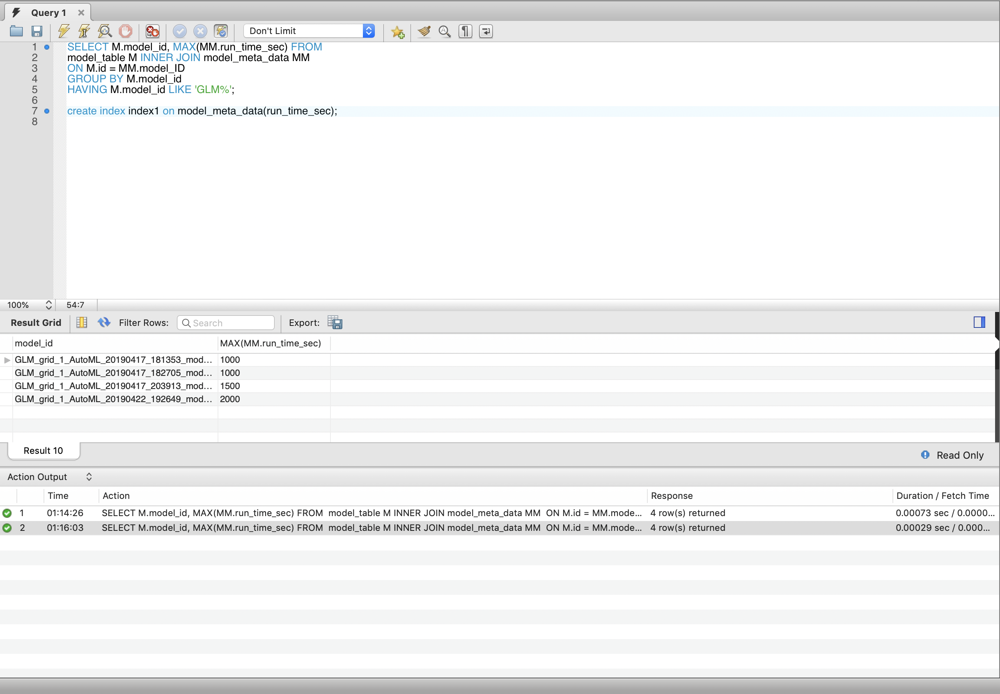

12. List out hyperparameter which has guassian in hyper_actual column.




SELECT HPT.hyper_parameter, HPV.hyper_actual FROM 
hyper_parameter_table HPT INNER JOIN hyper_parameter_values HPV 
ON HPT.id=HPV.hyper_id
WHERE HPV.hyper_actual='gaussian';

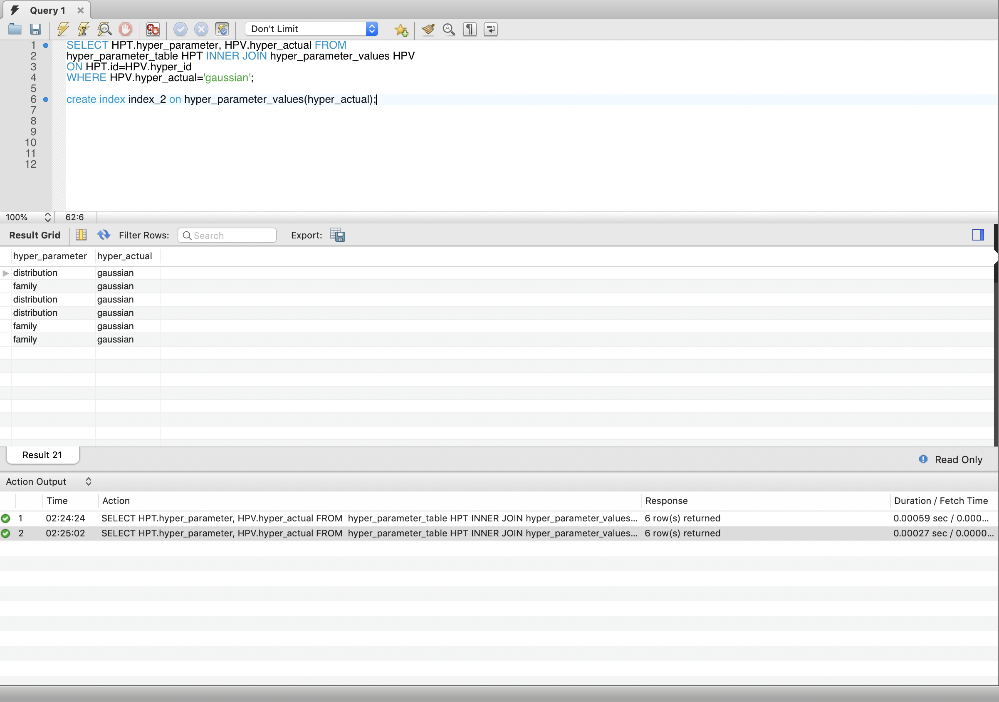

13. Find min rmse of GLM 




SELECT model_table.model_id, min(model_metrics.rmse) FROM 
model_table INNER JOIN model_metrics
ON model_table.id=model_metrics.model_id
GROUP BY model_id
HAVING model_id LIKE 'GLM%';

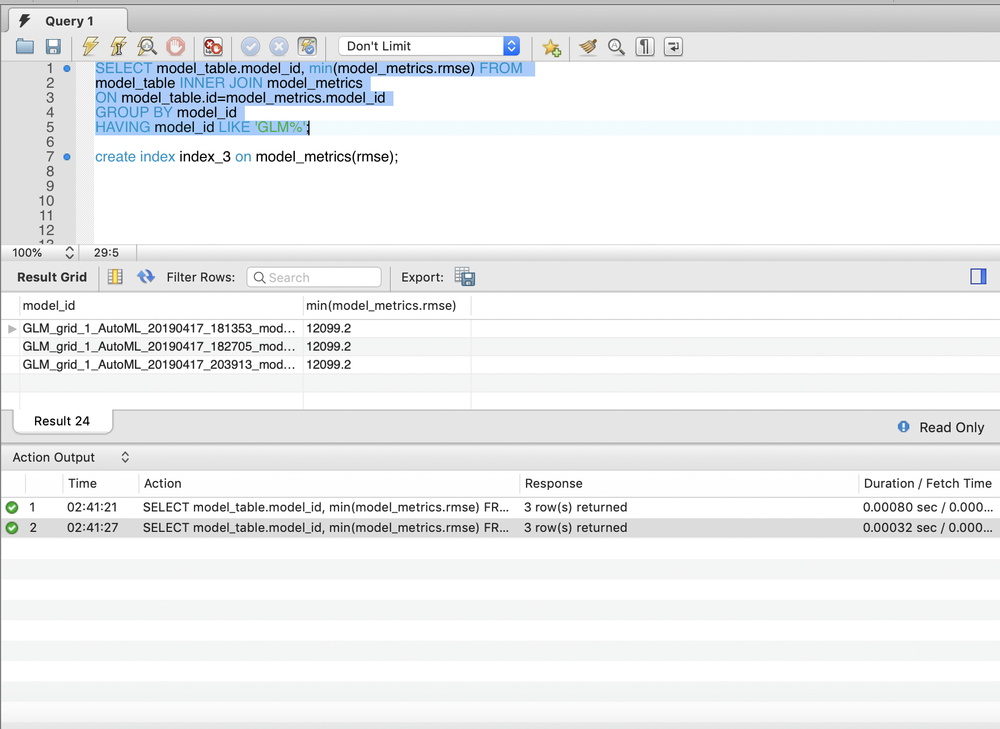

 14. Which model takes more than 100 ntrees?
 
 


SELECT HPT.model_id, HPT.hyper_parameter, HPV.hyper_actual FROM 
hyper_parameter_table HPT INNER JOIN hyper_parameter_values HPV 
ON HPT.id=HPV.hyper_id
WHERE hyper_parameter= "ntrees" and hyper_actual>'100';

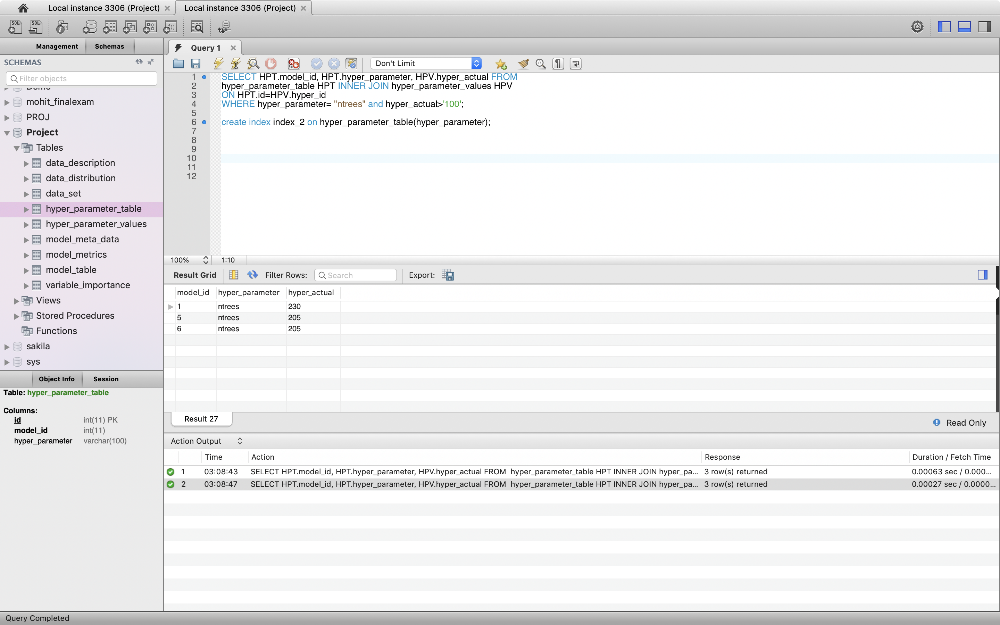

15. List max of max_depth hyperparameter for GBM model






select mt.model_id, mm.run_time_sec, hp.hyper_parameter,
hpv.hyper_actual from model_table mt INNER JOIN model_meta_data mm ON mt.id = mm.model_id INNER JOIN hyper_parameter_table hp ON mt.id = hp.model_id INNER JOIN hyper_parameter_values hpv ON
hpv.hyper_id = hp.id WHERE  mt.model_id like 'GBM%' and 
hpv.hyper_actual = (select MAX(hyper_actual) 
from hyper_parameter_values hpv INNER JOIN hyper_parameter_table hp
on hpv.hyper_id = hp.id where hp.hyper_parameter = 'max_depth');

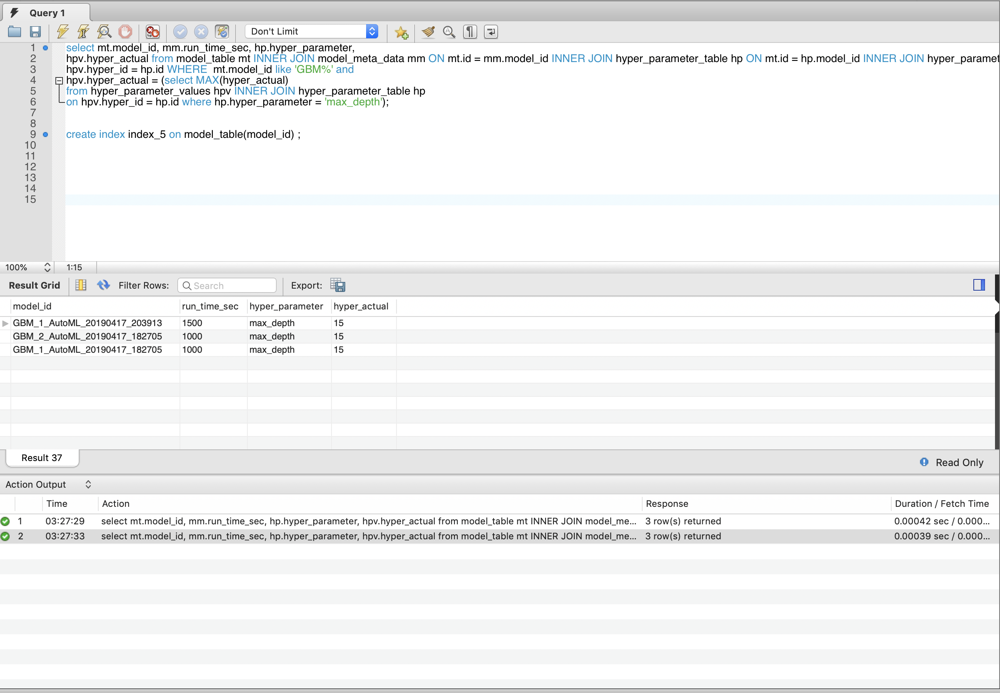